<a href="https://colab.research.google.com/github/HideLord/ChEATER-notebook/blob/master/MessengerManip.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install transliterate
!pip install adjustText
!pip install gender_guesser

    100% |████████████████████████████████| 51kB 2.0MB/s 
  Stored in directory: /root/.cache/pip/wheels/41/95/74/7d347e136d672f8bc28e937032bc92baf4f80856763a7e7b72
Successfully built adjustText
    100% |████████████████████████████████| 389kB 25.5MB/s 


In [23]:
from urllib.request import Request, urlopen
from bs4 import BeautifulSoup
import numpy as np
import matplotlib.mlab as mlab
import matplotlib.pyplot as plt
%matplotlib inline  
import math
from matplotlib.lines import Line2D
import bs4
import re
from google.colab import drive
from transliterate import translit
import gensim
from gensim.models import word2vec
import string, os

from __future__ import print_function
from keras.callbacks import LambdaCallback
from keras.models import Sequential
from keras.layers import Dense,Dropout
from keras.layers import LSTM
from keras.optimizers import RMSprop,Adam
from keras.utils.data_utils import get_file
from keras.models import load_model

import pandas as pd
import random
import sys
import io
import collections

from adjustText import adjust_text
from gender_guesser.detector import Detector

from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.manifold import Isomap,SpectralEmbedding,TSNE,MDS
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn import svm

drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [3]:
def bgToShlock(texts):
  finalStr = []
  for c in texts:
    if(c == 'я'): finalStr.append('q')
    elif(c == 'ъ'): finalStr.append('y')
    elif(c == 'ц'): finalStr.append('c')
    elif(c == 'ж' or c == 'й'): finalStr.append('j')
    else: finalStr.append(c)
  texts = ''.join(finalStr)
  texts = translit(texts, "bg", reversed=True)
  return texts

forbidden = 'are ama abe she ma kvo tva nali а автентичен аз ако ала бе без беше би бивш бивша бившо бил била били било благодаря близо бъдат бъде бяха в вас ваш ваша вероятно вече взема ви вие винаги внимава време все всеки всички всичко всяка във въпреки върху г ги главен главна главно глас го година години годишен д да дали два двама двамата две двете ден днес дни до добра добре добро добър докато докога дори досега доста друг друга други е евтин едва един една еднаква еднакви еднакъв едно екип ето живот за забавям зад заедно заради засега заспал затова защо защото и из или им има имат иска й каза как каква какво както какъв като кога когато което които кой който колко която къде където към лесен лесно ли лош м май малко ме между мек мен месец ми много мнозина мога могат може мокър моля момента му н на над назад най направи напред например нас не него нещо нея ни ние никой нито нищо но нов нова нови новина някои някой няколко няма обаче около освен особено от отгоре отново още пак по повече повечето под поне поради после почти прави пред преди през при пък първата първи първо пъти равен равна с са сам само се сега си син скоро след следващ сме смях според сред срещу сте съм със също т тази така такива такъв там твой те тези ти т.н. то това тогава този той толкова точно три трябва тук тъй тя тях у утре харесва хиляди ч часа че често чрез ще щом юмрук я як'
forbidden = bgToShlock(forbidden).split(' ')
generatedText = ['sent','voted','poll','admin','responded','removed','added','nickname','scored','group','EverWing','changed','премахна','добави','снимка','изпрати','plan','план','started','reminder','leaderboard']

print(forbidden)

soup = BeautifulSoup(open("gdrive/My Drive/message.html"), "html.parser")
messages = soup.findAll('div',{'class','pam _3-95 _2pi0 _2lej uiBoxWhite noborder'})
messages.reverse()
soup = BeautifulSoup(open("gdrive/My Drive/messageShitspam.html"), "html.parser")
messages.extend( soup.findAll('div',{'class','pam _3-95 _2pi0 _2lej uiBoxWhite noborder'}) )
print('collected messages: ', len(messages))


['are', 'ama', 'abe', 'she', 'ma', 'kvo', 'tva', 'nali', 'a', 'avtentichen', 'az', 'ako', 'ala', 'be', 'bez', 'beshe', 'bi', 'bivsh', 'bivsha', 'bivsho', 'bil', 'bila', 'bili', 'bilo', 'blagodarq', 'blizo', 'bydat', 'byde', 'bqha', 'v', 'vas', 'vash', 'vasha', 'veroqtno', 'veche', 'vzema', 'vi', 'vie', 'vinagi', 'vnimava', 'vreme', 'vse', 'vseki', 'vsichki', 'vsichko', 'vsqka', 'vyv', 'vypreki', 'vyrhu', 'g', 'gi', 'glaven', 'glavna', 'glavno', 'glas', 'go', 'godina', 'godini', 'godishen', 'd', 'da', 'dali', 'dva', 'dvama', 'dvamata', 'dve', 'dvete', 'den', 'dnes', 'dni', 'do', 'dobra', 'dobre', 'dobro', 'dobyr', 'dokato', 'dokoga', 'dori', 'dosega', 'dosta', 'drug', 'druga', 'drugi', 'e', 'evtin', 'edva', 'edin', 'edna', 'ednakva', 'ednakvi', 'ednakyv', 'edno', 'ekip', 'eto', 'jivot', 'za', 'zabavqm', 'zad', 'zaedno', 'zaradi', 'zasega', 'zaspal', 'zatova', 'zashto', 'zashtoto', 'i', 'iz', 'ili', 'im', 'ima', 'imat', 'iska', 'j', 'kaza', 'kak', 'kakva', 'kakvo', 'kakto', 'kakyv', 'kat

In [0]:
def parseData(): 
  userList = [i for i in range(len(messages))]
  textList = [i for i in range(len(messages))]
  reactsList = [i for i in range(len(messages))]
  timeList = [i for i in range(len(messages))]
  for i,m in enumerate(messages):
    if(i%100 == 0):
      print('\r{}/{}'.format(i,len(messages)),end='')
    user,text,reacts,time = None,None,None,None
    # user
    u = m.find('div',{'class','_3-96 _2pio _2lek _2lel'})
    if u is not None:
      user = u.text
    # message
    t = m.find('div',{'class','_3-96 _2let'})
    if t is not None:
      t = t.findNext().findNext().findNext()
      text = t.text
    # reacts
    r = m.find('ul',{'class','_tqp'})
    if r is not None:
      r = r.findChildren('li')
      reacts = [n.text for n in r]
    # time
    t = m.find('div',{'class','_3-94 _2lem'})
    if t is not None:
      time = t.text
    userList[i] = user
    textList[i] = text
    reactsList[i] = reacts
    timeList[i] = time
    
  data = pd.DataFrame({'user':userList,'text':textList,'reacts':reactsList,'time':timeList}, columns=['user','text','reacts','time'])
  return data

def getMostUsedWords(topN, userNames = None):
  texts = []
  if userNames is None:
    texts = data['text'].tolist()
  else:
    texts = data.loc[data['user'].isin(userNames)]['text'].tolist()
  texts = [t for t in texts if t is not None]
  texts = ('\n'.join([t for t in texts if not any(g in t for g in generatedText)])).lower()
  texts = bgToShlock(texts)
  
  tokens = texts.split()
  table = str.maketrans('', '', string.punctuation)
  tokens = [w.translate(table) for w in tokens]
  tokens = [word for word in tokens if word.isalpha()]
  tokens = [word.lower() for word in tokens]
  tokens = [word for word in tokens if word not in forbidden]
  
  wordcount = {}
  for word in tokens:
    if word not in wordcount:
      wordcount[word] = 1
    else:
      wordcount[word] += 1
  
  word_counter = collections.Counter(wordcount)
  return word_counter.most_common(topN)

def getMessagesPerUser():
  names = data.loc[data['user'].notnull()]['user'].tolist()  
  namecount = {}
  for name in names:
    
    if name not in namecount:
      namecount[name] = 1
    else:
      namecount[name] += 1
  
  name_counter = collections.Counter(namecount)
  return name_counter.most_common()

def getAveWordsPerUser():
  users = data.loc[data['user'].notnull()]['user'].tolist()  
  texts = data.loc[data['user'].notnull()]['text'].tolist()  
  users = [users[i] for i,t in enumerate(texts) if not any(g in t for g in generatedText)]
  texts = [t for t in texts if not any(g in t for g in generatedText)]
  
  table = str.maketrans('', '', string.punctuation)
  namecount = {}
  messageCounter = {}
  for i,name in enumerate(users):
    text = texts[i]
    text = bgToShlock(text)
    tokens = text.split()
    tokens = [w.translate(table) for w in tokens]
    tokens = [word for word in tokens if word.isalpha()]
    if name not in namecount:
      messageCounter[name] = 1
      namecount[name] = len(tokens)
    else:
      messageCounter[name] += 1
      namecount[name] += len(tokens)
      
  for n,v in messageCounter.items():
    namecount[n]/=v
  return collections.Counter(namecount).most_common()
      
def getTextFromUser(name):
    texts = []
    if len(name)==0:
      texts = data.loc[data['user'].notnull() & data['text'].notnull()][['user','text']]
    else:
      texts = data.loc[data['user'].notnull() & data['text'].notnull() & data['user'].isin(name)][['user','text']]
    allTexts = str()
    prev = "."
    for index, row in texts.iterrows():
      sender = str(row['user'])
      text =   str(row['text']).lower()
      
      if any(g in text for g in generatedText):
        continue

      if sender != prev:
        allTexts += '\n'
      else:
        allTexts += ' '
      allTexts += text
        
      prev = str(sender)
      
    finalStr = []

    allTexts = allTexts.lower()

    for c in allTexts:
      if(c == 'я'): finalStr.append('q')
      elif(c == 'ъ'): finalStr.append('y')
      elif(c == 'ц'): finalStr.append('c')
      elif(c == 'ж'): finalStr.append('j')
      elif(c == ','): finalStr.append(' , ')
      elif(c == '\"'): finalStr.append(' \" ')
      elif(c == '\''): finalStr.append(' \' ')
      elif(c == '('): finalStr.append(' ( ')
      elif(c == ')'): finalStr.append(' ) ')
      elif(c == '?'): finalStr.append(' ? ')
      elif(c == '!'): finalStr.append(' ! ')
      elif(c == '.'): finalStr.append(' . ')
      elif(c == ';'): finalStr.append(' ; ')
      elif(c == ':'): finalStr.append(' : ')
      elif(c == '*'): finalStr.append(' * ')
      elif(c == '/'): finalStr.append(' / ')
      elif(c == '@'): finalStr.append(' @ ')
      elif(c == '\\'): finalStr.append(' \\ ')
      else: finalStr.append(c)

    allTexts = ''.join(finalStr)
    allTexts = translit(allTexts, "bg", reversed=True)
    allTexts = re.sub(' +', ' ', allTexts)
    return allTexts

In [5]:
data = parseData()
print("\n")
print(data.head(10))


146700/146763              user                                               text reacts  \
0      Alex Savova  дневника named the group Втора група 💎👗👗💎зарад...   None   
1       Ivan Kirev                   Не и флейм named the group 💎👗👗💎.   None   
2      Alex Savova                   дневника added you and 3 others.   None   
3      Alex Savova      дневника added Boyan Ivandjikov and 4 others.   None   
4      Alex Savova                      дневника added a participant.   None   
5     Georgi Rulev                                              ?????   None   
6    Yoana Pavlova                     a spomenite ot starata grupa??   None   
7      Alex Savova         дневника added Любен Тодоров and 3 others.   None   
8      Alex Savova  Жертваме ги в полза на колектива.... *Кирев е ...   None   
9  Жаклин Ковачева                                   Някой от школата   None   

                    time  
0  Jun 20, 2016, 9:45 AM  
1  Jun 20, 2016, 9:45 AM  
2  Jun 20, 2016, 9:45 AM 

TODO:

1.   Time distribution
2.   doublesided barchart with num messages and messages per day


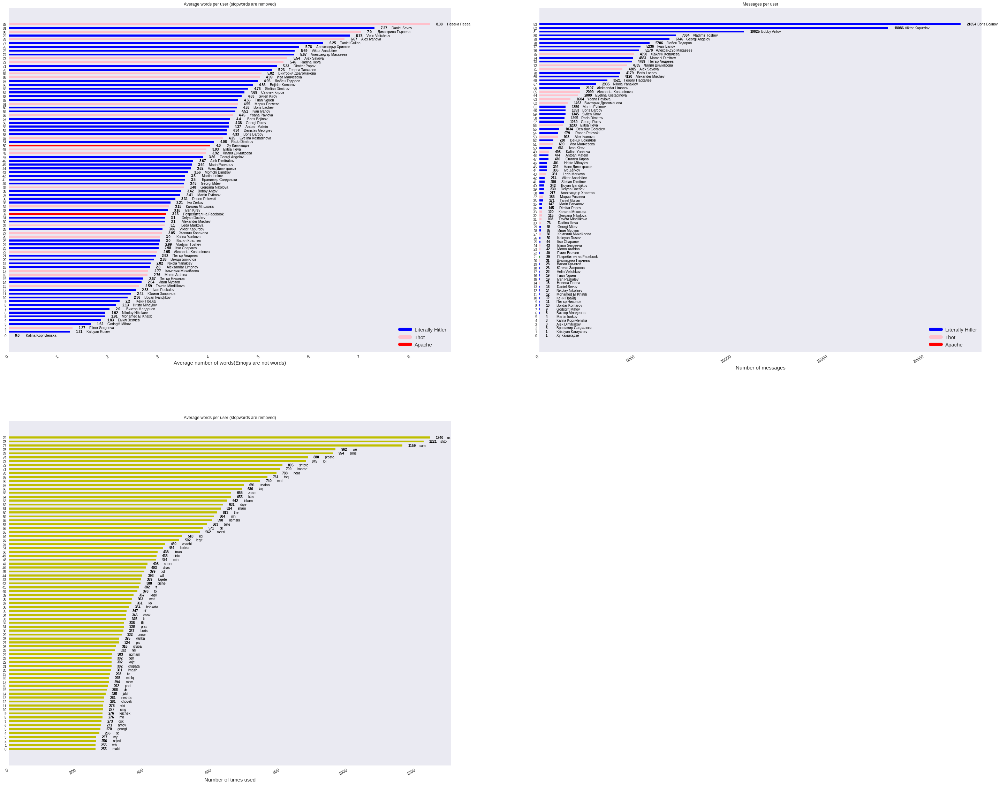

In [40]:
guesser = Detector()

fig = plt.figure()
fig.set_size_inches(50, 40, forward=True)
#plt.subplots_adjust(bottom=10,top=11)

custom_lines = [Line2D([0], [0], color='b', lw=10),
                Line2D([0], [0], color='pink', lw=10),
                Line2D([0], [0], color='red', lw=10)]

#-------------------------------------------------------------------------------
# Average words per user
#-------------------------------------------------------------------------------
ax = fig.add_subplot(221)

users = getAveWordsPerUser()
x = [a for key,a in users]
names = [a for a,val in users]

x.reverse()
names.reverse()

namesShlock = [translit(n.split()[0], "bg", reversed=True).lower().capitalize() for n in names]
namesShlock = [n.replace('Zh','J').replace('zh','j').replace('ks','x').replace('ts','c').replace('Ts','C') for n in namesShlock]
gender = [guesser.get_gender(n) for n in namesShlock]
genderDict = {'Godsgift':'male','Keni':'male','Venci':'male','Jaklin':'female','Momchi':'male','Alek':'male','Alex':'female','Denislav':'male','Yoana':'female','Taniel':'male','Tuan':'male'}
for i,g in enumerate(gender):
  if namesShlock[i] in genderDict:
    g = genderDict[namesShlock[i]]
  if g == 'male':
    gender[i] = 'b'
  elif g == 'female':
    gender[i] = 'pink'
  else:
    gender[i] = 'red'

index = np.arange(len(x))
bar_width = 0.5

rect = ax.barh(index, x, bar_width, color=gender)

ax.grid(False)

for i, v in enumerate(x):
    ax.text(v+(max(x)/70), i, str(round(v,2)), color='Black', fontweight='bold', verticalalignment='center')
    ax.text(v+(max(x)/25), i, str(names[i]), color='Black', verticalalignment='center')
ax.set_xlabel('Average number of words(Emojis are not words)',fontsize=15)
ax.set_yticks(index)
ax.set_title('Average words per user (stopwords are removed)')
ax.legend(custom_lines, ['Literally Hitler', 'Thot', 'Apache'], loc='lower right',fontsize=15)

plt.setp(ax.get_xticklabels(), rotation=30, horizontalalignment='right',fontsize=12)

#-------------------------------------------------------------------------------
# Number of messages per user
#-------------------------------------------------------------------------------
ax = fig.add_subplot(222)

users = getMessagesPerUser()
x = [a for key,a in users]
names = [a for a,val in users]

x.reverse()
names.reverse()

namesShlock = [translit(n.split()[0], "bg", reversed=True).lower().capitalize() for n in names]
namesShlock = [n.replace('Zh','J').replace('zh','j').replace('ks','x').replace('ts','c').replace('Ts','C') for n in namesShlock]
gender = [guesser.get_gender(n) for n in namesShlock]

for i,g in enumerate(gender):
  if namesShlock[i] in genderDict:
    g = genderDict[namesShlock[i]]
  if g == 'male':
    gender[i] = 'b'
  elif g == 'female':
    gender[i] = 'pink'
  else:
    gender[i] = 'green'

index = np.arange(len(x))
bar_width = 0.5

rect = ax.barh(index, x, bar_width, color=gender)

ax.grid(False)

for i, v in enumerate(x):
    ax.text(v+(max(x)/70), i, str(round(v,2)), color='Black', fontweight='bold', verticalalignment='center')
    ax.text(v+(max(x)/25), i, str(names[i]), color='Black', verticalalignment='center')
ax.set_xlabel('Number of messages',fontsize=15)
ax.set_yticks(index)
ax.set_title('Messages per user')
ax.legend(custom_lines, ['Literally Hitler', 'Thot', 'Apache'], loc='lower right',fontsize=15)

plt.setp(ax.get_xticklabels(), rotation=30, horizontalalignment='right',fontsize=12)

#-------------------------------------------------------------------------------
# Most frequent words
#-------------------------------------------------------------------------------
ax = fig.add_subplot(223)

users = getMostUsedWords(80)
x = [a for key,a in users]
names = [a for a,val in users]

x.reverse()
names.reverse()

index = np.arange(len(x))
bar_width = 0.5

rect = ax.barh(index, x, bar_width, color='y')

ax.grid(False)

for i, v in enumerate(x):
    ax.text(v+(max(x)/75), i, str(round(v,2)), color='Black', fontweight='bold', verticalalignment='center')
    ax.text(v+(max(x)/25), i, str(names[i]), color='Black', verticalalignment='center')
ax.set_xlabel('Number of times used',fontsize=15)
ax.set_yticks(index)
ax.set_title('Average words per user (stopwords are removed)')

plt.setp(ax.get_xticklabels(), rotation=30, horizontalalignment='right',fontsize=12)
plt.show()


In [0]:
def get_clear_sentences(doc):
  doc = doc.splitlines()
  sentences = []
  for line in doc:
    tokens = line.split()
    table = str.maketrans('', '', string.punctuation)
    tokens = [w.translate(table) for w in tokens]
    tokens = [word for word in tokens if word.isalpha()]
    tokens = [word.lower() for word in tokens]
    if(len(tokens)!=0):sentences.append(list(tokens))
  return sentences

def remove_rare_chars(text,threshold):
  temp = dict()
  cleanText = []
  for c in text:
    if c in temp:
      temp[c] += 1
    else:
      temp[c] = 1
  for c in text:
    if temp[c] < threshold and not c.isalpha() : continue
    else: cleanText.append(c)
  text = ''.join(cleanText)
  text = re.sub(' +', ' ', text)
  text = "\n".join([ll.rstrip() for ll in text.splitlines() if ll.strip()])
  return text

def wordToVec(text, window = 10, epochs = 50, numVectors = 50, padding = False):
  sentences = get_clear_sentences(text)
  if(padding):
    for i,s in enumerate(sentences):
      if(len(s) < window):
        k = window-len(s)
        sentences[i] = ['extend' for i in range(round(k/2))] + s + ['extend' for i in range(round(k/2))]
  print(sentences[:100])
  model = gensim.models.Word2Vec(
        sentences,
        size=numVectors,
        window=window,
        min_count=5,
        workers=10)
  model.train(sentences, total_examples=len(sentences), epochs=epochs)
  model.save('mymodel')
  
def query(word):
  model = gensim.models.word2vec.Word2Vec.load('mymodel')
  print(word + " -> ", end='')
  print(model.most_similar(word))

In [43]:
numVectors = 100
#text = getTextFromUser(['Alex Savova','Svilen Kirov','Elitsa Ilieva','Alex Ivanova','Жаклин Ковачева','Лилия Димитрова','Димитрина Гърчева','Виктория Драгоманова'])

text = getTextFromUser([])
text = remove_rare_chars(text,75)

wordToVec(text, window=2, epochs=15, numVectors=numVectors, padding = False)

[['a', 'spomenite', 'ot', 'starata', 'grupa'], ['jertvame', 'gi', 'v', 'polza', 'na', 'kolektiva', 'kirev', 'e', 'vinoven'], ['nqkoy', 'ot', 'shkolata', 'kakvo', 'pravite'], ['warten'], ['i', 'iskate', 'li', 'da', 'doyde', 'nqkoy', 'da', 'me', 'vzeme', 'i', 'vylkova', 'doshla', 'li', 'e'], ['ot', 'chasa', 'li'], ['mhm'], ['black', 'widow', 'set', 'the', 'emoji', 'to'], ['moje', 'li', 'koito', 'e', 'v', 'chas', 'kato', 'svurshi', 'chasa', 'i', 'alexabdrov', 'si', 'trugne', 'da', 'proveri', 'dnevnika', 'ocenkite', 'po', 'mat', 'i', 'da', 'gi', 'snima', 'srochni', 'sip', 'i', 'zp'], ['zashto', 'e', 'bqlo'], ['kc', 'kva', 'e', 'taq', 'grupa'], ['kirev', 'ne', 'moje', 'da', 'byde', 'dobaven', 'v', 'drugata', 'i', 'zatova', 'e', 'syzdadena', 'tazi'], ['tuk', 'nqmame', 'prqkori'], ['prava', 'si'], ['snimaite', 'dnevnika', 'pls'], ['nqkoy', 'da', 'e', 'vijdal', 'vzimal', 'telefona', 'na', 'svilen'], ['klyaka', 'bez', 'da', 'aka', 'set', 'the', 'emoji', 'to'], ['neshto', 'set', 'the', 'new', 'h

In [44]:
query('pesheva')
query('ponedelnik')
query('lv')
query('mat')
query('kircho')

pesheva -> [('tuncheva', 0.764427661895752), ('testovete', 0.7181307077407837), ('teatyra', 0.7040150165557861), ('shkolata', 0.6983797550201416), ('sashko', 0.6957107782363892), ('roditelskata', 0.6874983310699463), ('uchitelite', 0.687014102935791), ('bojikova', 0.6801978945732117), ('testa', 0.6791797876358032), ('srokyt', 0.679053783416748)]
ponedelnik -> [('petyk', 0.8643588423728943), ('chetvyrtyk', 0.8492397665977478), ('srqda', 0.8342628479003906), ('petuk', 0.7851755023002625), ('vtornik', 0.7767670154571533), ('blok', 0.7448288202285767), ('sybota', 0.7356422543525696), ('mesec', 0.7266973257064819), ('fevruari', 0.7192365527153015), ('pon', 0.6970651149749756)]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:49: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
/usr/local/lib/python3.6/dist-packages/gensim/matutils.py:737: FutureWarning: Conversion of the second argument of issubdtype from `int` to `np.signedinteger` is deprecated. In future, it will be treated as `np.int64 == np.dtype(int).type`.
  if np.issubdtype(vec.dtype, np.int):


lv -> [('kaparo', 0.7828981876373291), ('leva', 0.7420170307159424), ('belejnici', 0.7049943804740906), ('belejnicite', 0.7022329568862915), ('sybirame', 0.6963211297988892), ('deklaraciite', 0.6860477924346924), ('stipendiite', 0.683876633644104), ('kinta', 0.6818705797195435), ('onezi', 0.6689921617507935), ('sybiram', 0.6674585342407227)]
mat -> [('bel', 0.8771092891693115), ('fizika', 0.8600797057151794), ('geografiq', 0.8446445465087891), ('istoriq', 0.8396910429000854), ('geo', 0.8329722285270691), ('matematika', 0.8299160003662109), ('nemski', 0.8250327110290527), ('filosofiq', 0.8223487138748169), ('literatura', 0.814800500869751), ('biologiq', 0.8081921339035034)]
kircho -> [('mat', 0.7938636541366577), ('istoriq', 0.7775368690490723), ('geo', 0.7704817056655884), ('nemski', 0.7631149888038635), ('bel', 0.7582479119300842), ('tunchaka', 0.7561727166175842), ('kontrolno', 0.7482095956802368), ('bylgarski', 0.7479516863822937), ('geografiq', 0.7448289394378662), ('eseto', 0.7432

In [0]:
def getTransformed(embedder, **kwargs):
  model = gensim.models.word2vec.Word2Vec.load('mymodel')
  words = []
  for w in model.wv.vocab:
    words.append(model.wv.get_vector(w))

  wordsTransformed = []

  if embedder == 'pca':
    pca = PCA(n_components=2, svd_solver='auto')
    wordsTransformed = pca.fit_transform(words)
    print(pca.explained_variance_ratio_)

  if embedder == 'tsne':
    tsne = TSNE(n_components=2, verbose=1, perplexity=kwargs['perplexity'], n_iter=kwargs['n_iter'], early_exaggeration=kwargs['exaggeration'])
    wordsTransformed = tsne.fit_transform(words)

  if embedder == 'iso':
    iso = Isomap(n_neighbors=2, neighbors_algorithm='ball_tree', n_components=2)
    wordsTransformed = iso.fit_transform(words)
    
  if embedder == 'spectral':
    spec = SpectralEmbedding(n_components=2)
    wordsTransformed = spec.fit_transform(words)

  if embedder == 'mds':
    mds = MDS(n_components=2)
    wordsTransformed = mds.fit_transform(words)
  
  if embedder == 'lda':
    lda = LinearDiscriminantAnalysis(n_components=2)
    wordsTransformed = lda.fit(words, kwargs['wordsY']).transform(X)
  
  if embedder == 'none':
    wordsTransformed = words
    
  return wordsTransformed

def removeOutliers(wordsTransformed,remove = True,nu=0.5):
  if remove == False:
    inliers = [1 for i in range(len(wordsTransformed))]
    return wordsTransformed,inliers
  clf = svm.OneClassSVM(nu=nu, kernel="rbf", gamma='auto',)
  inliers = clf.fit_predict(wordsTransformed)
  wordsTransformed = [w for i,w in enumerate(wordsTransformed) if inliers[i]==1]
  return (wordsTransformed,inliers)

def makeClusters(words = None, num_clusters = 8, elbow = False):
  if words == None:
    model = gensim.models.word2vec.Word2Vec.load('mymodel')
    words = []  
    for w in model.wv.vocab:
      words.append(model.wv.get_vector(w))  
  
  if elbow:
    nc = range(1,20)

    kmeans = [KMeans(n_clusters=i) for i in nc]
    score = [kmeans[i].fit(words).score(words) for i in range(len(kmeans))]
    
    p1 = np.array([nc[0],score[0]])
    p2 = np.array([nc[-1],score[-1]])
    maxi, maxX = 0,0
    for x in nc:
      y = score[x-1]
      p3 = np.array([x,y])
      d = np.abs(np.cross(p2-p1, p1-p3)) / np.linalg.norm(p2-p1)
      print(d)
      if d > maxi:
        maxi = d
        maxX = x
    
    print('Optimal clusters: {}'.format(maxX))
    
    plt.plot(nc,score)
    plt.xlabel('Number of Clusters')
    plt.ylabel('Score')
    plt.title('Elbow Curve')
    plt.scatter(maxX,score[maxX-1],c='r')
    plt.show()
   
  
  clusters = KMeans(n_clusters = num_clusters, init = 'k-means++', n_init = 20).fit(words)
  
  return clusters.labels_

In [0]:
def plotEmbeddedWords(addText = True, **kwargs):
  print('Constructing clusters. . .')
  clusters = makeClusters(None,5,False)
  
  print('Reducing dimensionality. . .')
  model = gensim.models.word2vec.Word2Vec.load('mymodel')
  wordsTransformed = getTransformed(embedder = kwargs['embedder'], perplexity = kwargs['perplexity'], n_iter = kwargs['n_iter'], exaggeration = kwargs['exaggeration'], wordsY = clusters)
  
  print('Removing outliers. . .')
  wordsTransformed, inliers = removeOutliers(wordsTransformed,remove=True,nu=0.1)

  custom_colors = {0:'deepskyblue',1:'springgreen',2:'violet',3:'y',4:'lightsalmon',5:'r',6:'c'}
  clusters = [custom_colors[c] for i,c in enumerate(clusters) if inliers[i]==1]

  realInd = np.zeros((len(inliers)))
  br = 0
  for i in range(len(inliers)):
    if inliers[i] == 1:
      realInd[i] = br
      br+=1;
  x, y = zip(*wordsTransformed)
  fig = plt.figure(1)
  fig.set_size_inches(50, 35)
  plt.scatter(x,y,alpha=0.65,cmap=plt.get_cmap('brg'),c=clusters,s=120)
  
  clusterCounter = {}
  clusterSize = {}
  for i in range(len(inliers)):
    if(inliers[i]==-1):
      continue
    ri = int(realInd[i])
    if(clusters[ri] not in clusterCounter):
      clusterCounter[clusters[ri]] = 1
    if(clusters[ri] in clusterSize):
      clusterSize[clusters[ri]] += 1
    else:
      clusterSize[clusters[ri]] = 1

  if addText:
    print('Plotting words. . .')
    wordStr = []
    permitted = ['vankata','vanka','lili','elitsa','hristov','barbov','sashko','alexandrov','valdi','vladi','leva','lv','kircho','kirev','tuncheva','mat','matematika','bel','istoriq','informatika','savova','martinka','vylkova','vulkova','pari',
                'teatyr','evi','svilen','eli','ponedelnik','vtornik','srqda','chetvyrtyk','geo','geografiq','petyk','sneji','deni','kontrolno','zakysnqvam','lyuben','alex','viki','dom','dr','domashno','joro','jorj','gay','mirchev','alexandyr','yo',
                 'koprivlenska','gei','kapi','momchi','kur','cici','ivan','lachev','rado','bate','ok','boi','ebem','sex','sladka','cute','girl','never','bring','us','down','alexander','liliq','until','hour','plan','started','snimka','pesheva',
                 'uchitel','tq','mama','prepodava','ive','bobka','martina','qnakiev','radina','ushagelov','pet','joined','svyrshena','vakanciq','napomnq','krayniqt','srok','sybirame']
    for i,w in enumerate(model.wv.vocab):
      if(inliers[i]==-1):
        continue
      ri = int(realInd[i])
      if(w in permitted):
        wordStr.append((w,ri))
        continue
      closeW = model.wv.most_similar(w,topn=35)
      if any(cw in permitted for cw in closeW):
        wordStr.append((w,ri))
        print(w)
        continue
      if clusterCounter[clusters[ri]] < clusterSize[clusters[ri]]/6:
        clusterCounter[clusters[ri]] += 1
        wordStr.append((w,ri))

    print('Adjusting overlapping text (This may take awhile). . .')
    texts = [plt.text(x[t[1]], y[t[1]], '%s' %t[0], fontsize = 12) for i,t in enumerate(wordStr)]
    print(str(adjust_text(texts,lim=40,arrowprops=dict(arrowstyle='->', color='red'))))  
  plt.show()
  fig.savefig('gdrive/My Drive/Graphs/tsne{}.svg'.format(str(kwargs["perplexity"])+"_"+str(kwargs["exaggeration"])))
  fig.savefig('gdrive/My Drive/Graphs/tsne{}.png'.format(str(kwargs["perplexity"])+"_"+str(kwargs["exaggeration"])))  

0.0
2.965726728818032
4.958123614688612
5.77350824389772
6.224360167009689
6.127014667296733
5.994112989981421
5.821215561679345
5.5972328441068715
5.216236759603527
4.787016601387807
4.359479147487825
3.816067371967383
3.243817442939371
2.582552270545241
1.991303343784477
1.315341313884043
0.623915988264827
0.0
Optimal clusters: 5


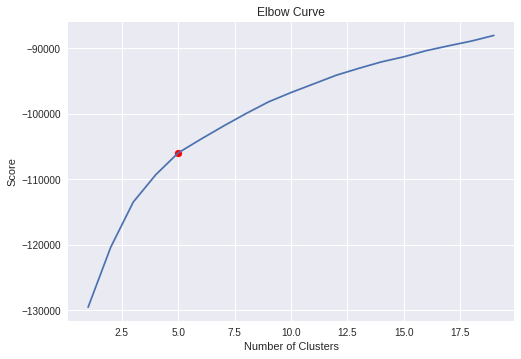

array([4, 5, 4, ..., 0, 4, 4], dtype=int32)

In [0]:
makeClusters(words = None, num_clusters = 8, elbow = True)

Gen 0...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.024s...
[t-SNE] Computed neighbors for 7761 samples in 12.983s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.745276
[t-SNE] KL divergence after 250 iterations with early exaggeration: 25.702087
[t-SNE] KL divergence after 500 iterations: 3.576434
Removing outliers. . .


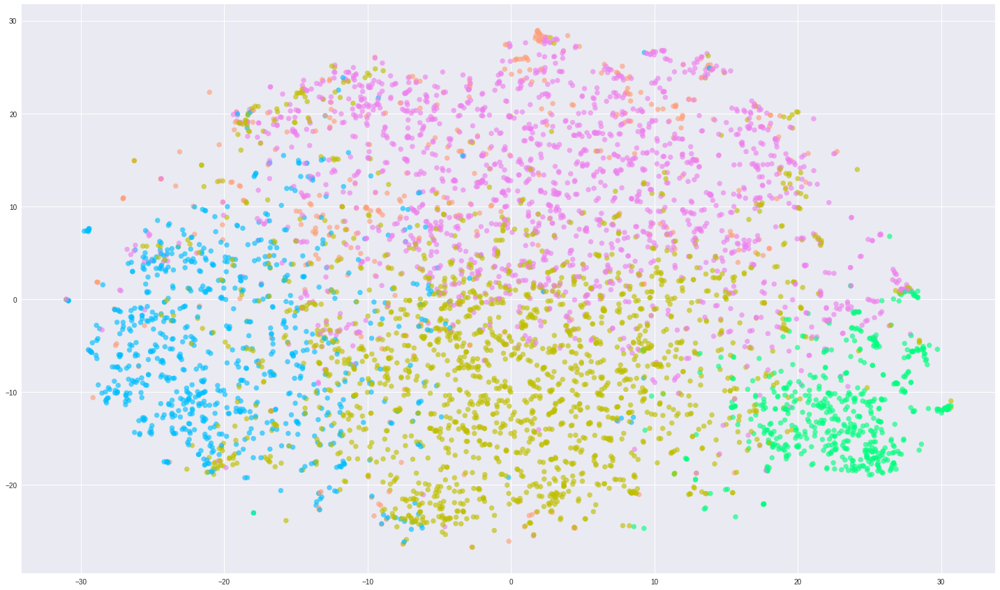

Gen 1...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.024s...
[t-SNE] Computed neighbors for 7761 samples in 13.300s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.797966
[t-SNE] KL divergence after 250 iterations with early exaggeration: 24.439445
[t-SNE] KL divergence after 500 iterations: 3.424746
Removing outliers. . .


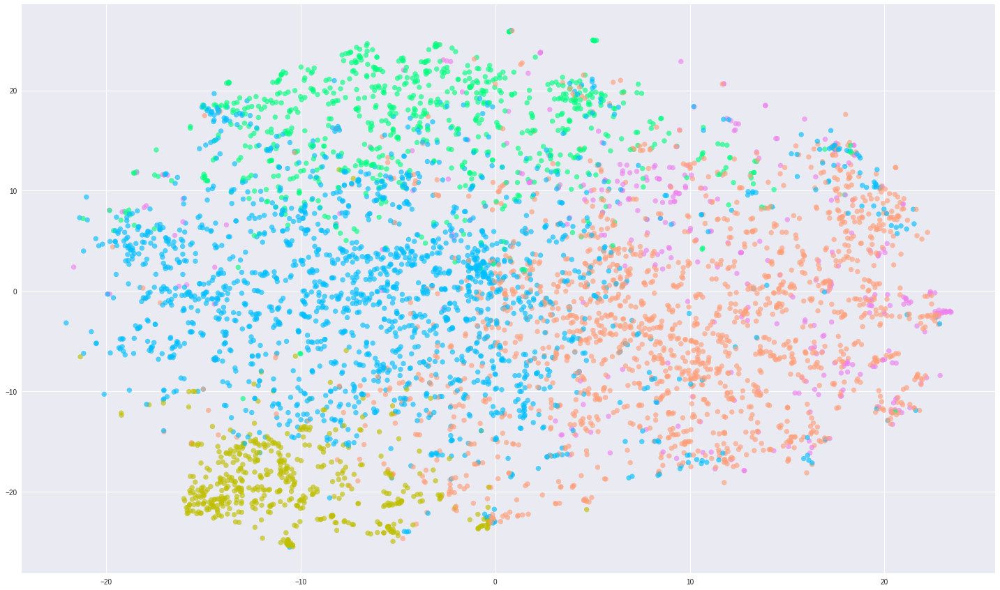

Gen 2...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.026s...
[t-SNE] Computed neighbors for 7761 samples in 13.354s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.835009
[t-SNE] KL divergence after 250 iterations with early exaggeration: 23.288979
[t-SNE] KL divergence after 500 iterations: 3.301862
Removing outliers. . .


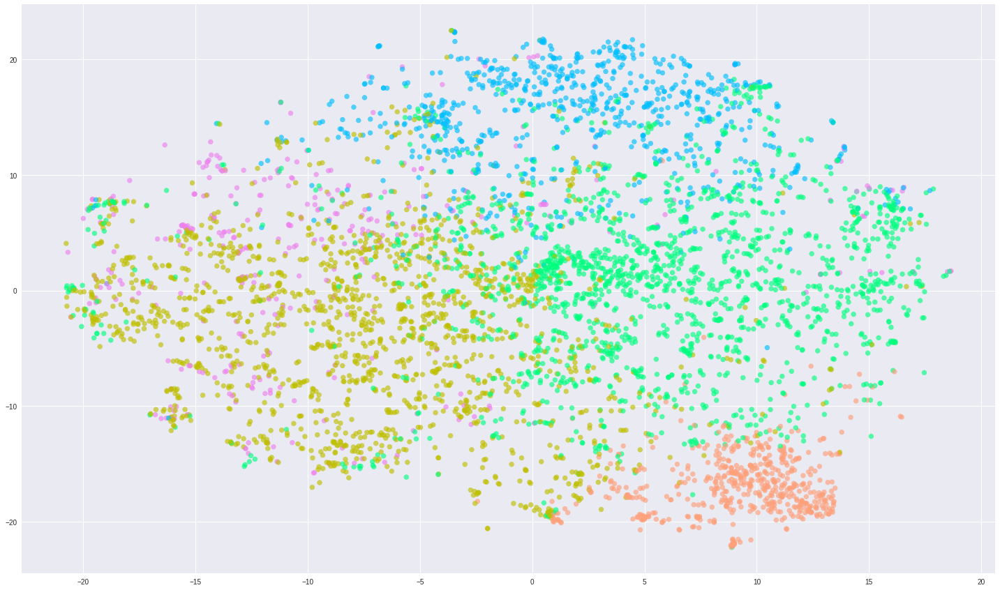

Gen 3...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.025s...
[t-SNE] Computed neighbors for 7761 samples in 13.196s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.863779
[t-SNE] KL divergence after 250 iterations with early exaggeration: 22.654844
[t-SNE] KL divergence after 500 iterations: 3.180017
Removing outliers. . .


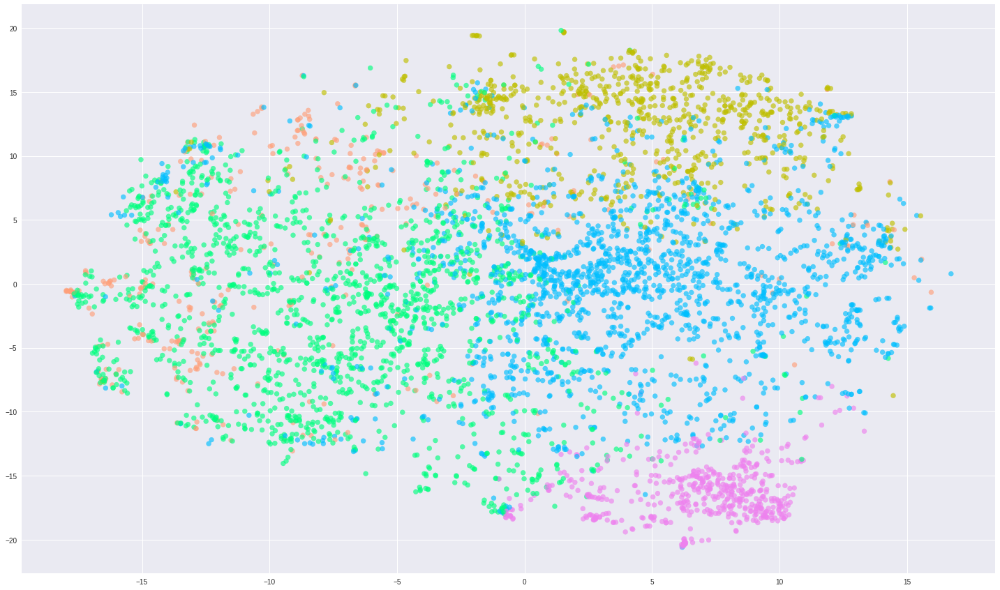

Gen 4...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 181 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.024s...
[t-SNE] Computed neighbors for 7761 samples in 13.514s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.887399
[t-SNE] KL divergence after 250 iterations with early exaggeration: 21.694071
[t-SNE] KL divergence after 500 iterations: 3.078177
Removing outliers. . .


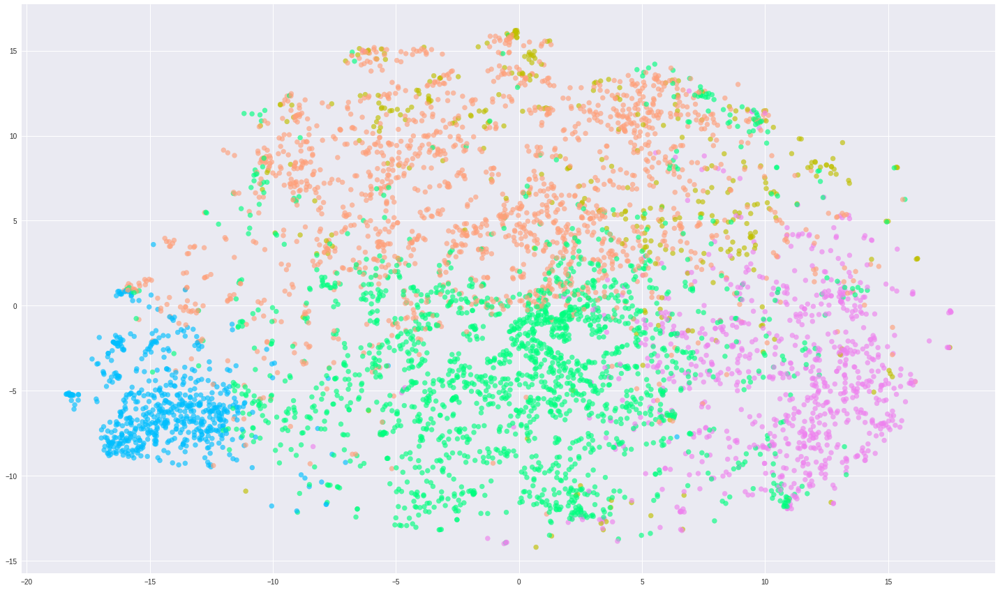

Gen 5...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 211 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.024s...
[t-SNE] Computed neighbors for 7761 samples in 13.292s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.907503
[t-SNE] KL divergence after 250 iterations with early exaggeration: 21.195002
[t-SNE] KL divergence after 500 iterations: 3.021375
Removing outliers. . .


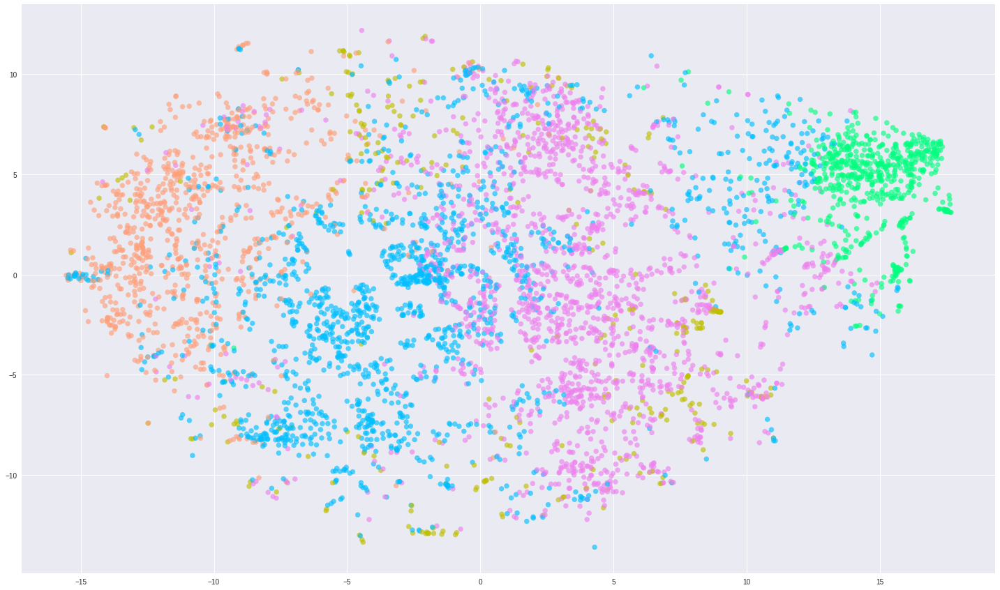

Gen 6...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 241 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.035s...
[t-SNE] Computed neighbors for 7761 samples in 13.695s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.925057
[t-SNE] KL divergence after 250 iterations with early exaggeration: 20.620127
[t-SNE] KL divergence after 500 iterations: 2.906163
Removing outliers. . .


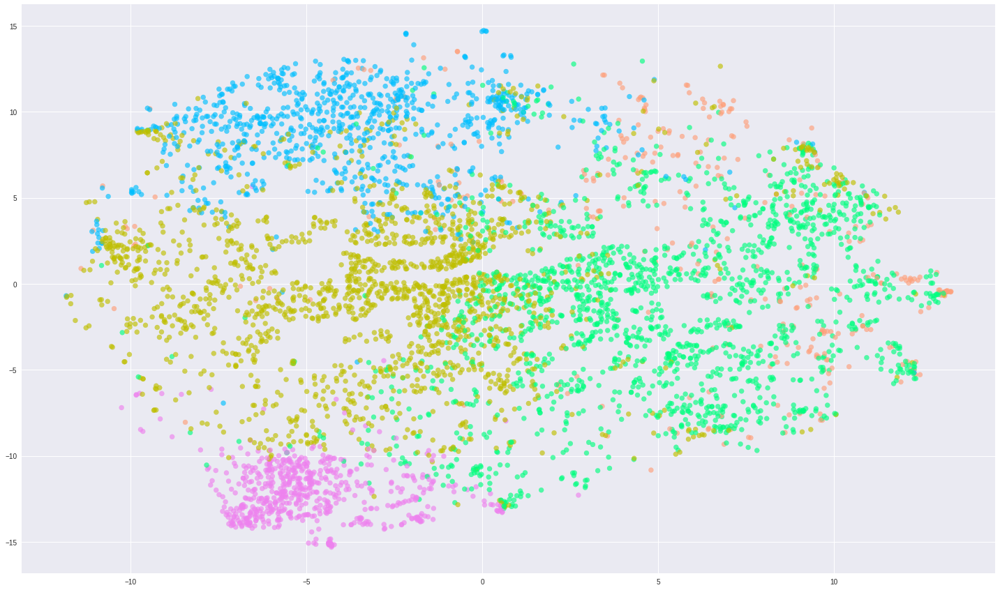

Gen 7...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 271 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.024s...
[t-SNE] Computed neighbors for 7761 samples in 13.507s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.940666
[t-SNE] KL divergence after 250 iterations with early exaggeration: 20.177055
[t-SNE] KL divergence after 500 iterations: 2.830519
Removing outliers. . .


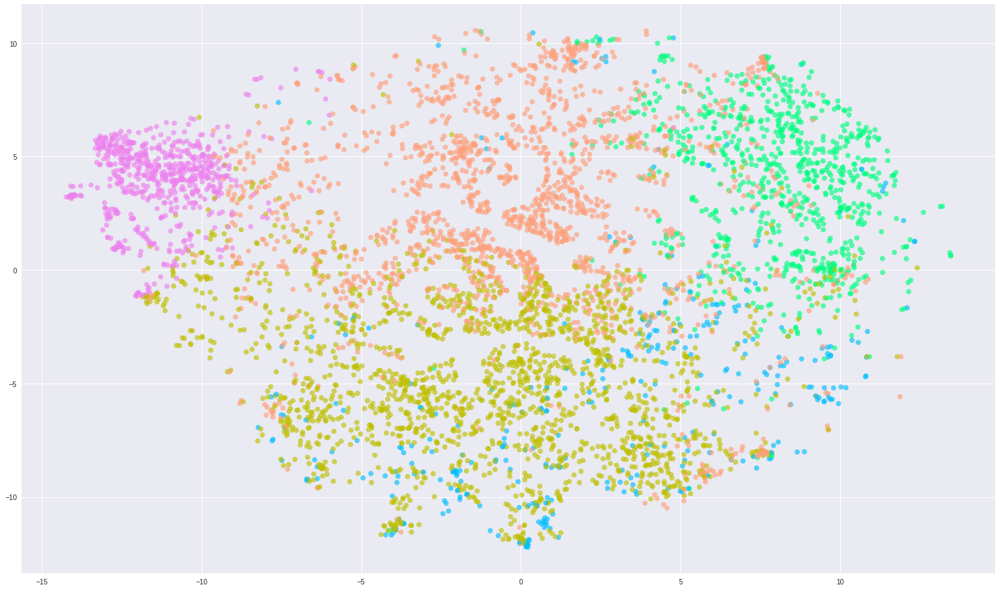

Gen 8...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 301 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.025s...
[t-SNE] Computed neighbors for 7761 samples in 13.904s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.954755
[t-SNE] KL divergence after 250 iterations with early exaggeration: 19.823713
[t-SNE] KL divergence after 500 iterations: 2.763173
Removing outliers. . .


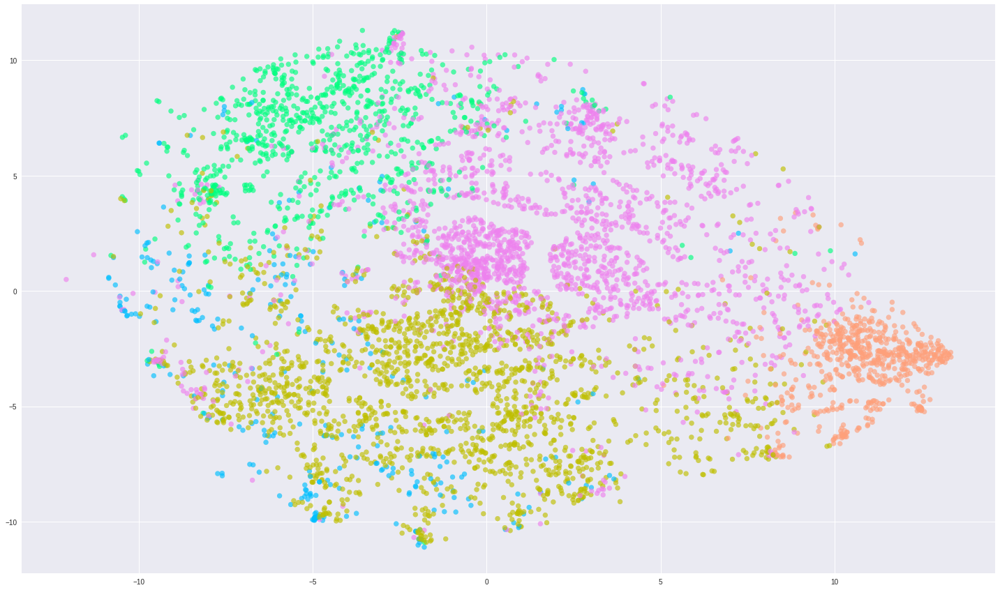

Gen 9...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 331 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.024s...
[t-SNE] Computed neighbors for 7761 samples in 13.711s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.967617
[t-SNE] KL divergence after 250 iterations with early exaggeration: 19.444845
[t-SNE] KL divergence after 500 iterations: 2.703582
Removing outliers. . .


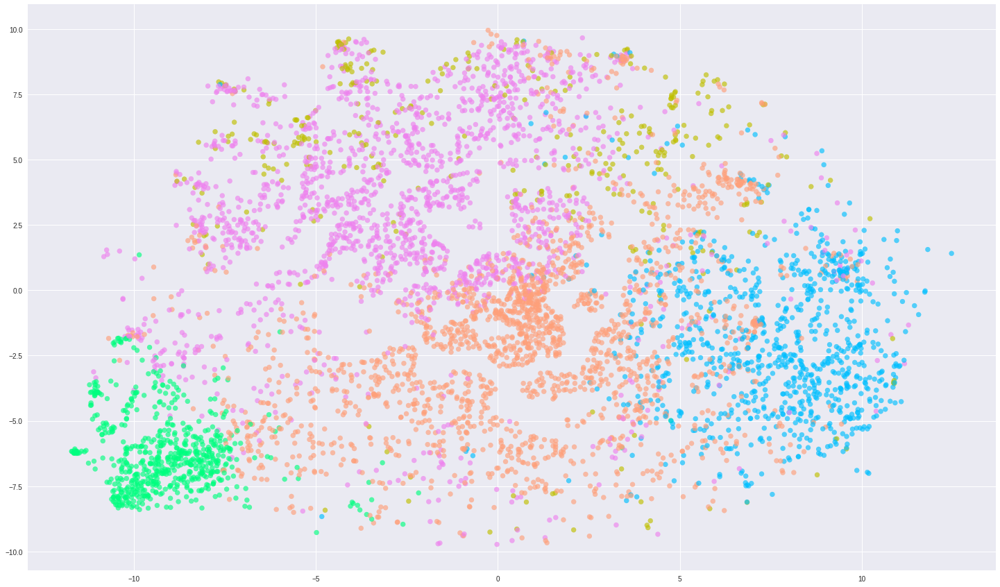

Gen 10...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 451 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.024s...
[t-SNE] Computed neighbors for 7761 samples in 14.293s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 1.010439
[t-SNE] KL divergence after 250 iterations with early exaggeration: 18.225569
[t-SNE] KL divergence after 500 iterations: 2.484717
Removing outliers. . .


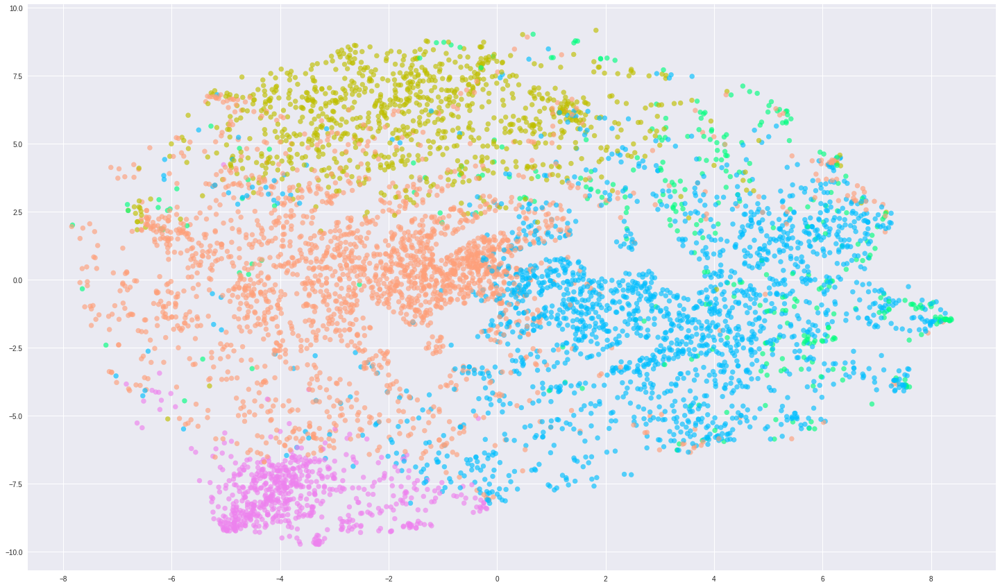

Gen 11...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 901 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.026s...
[t-SNE] Computed neighbors for 7761 samples in 15.115s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 1.114392
[t-SNE] KL divergence after 250 iterations with early exaggeration: 15.526884
[t-SNE] KL divergence after 500 iterations: 2.048836
Removing outliers. . .


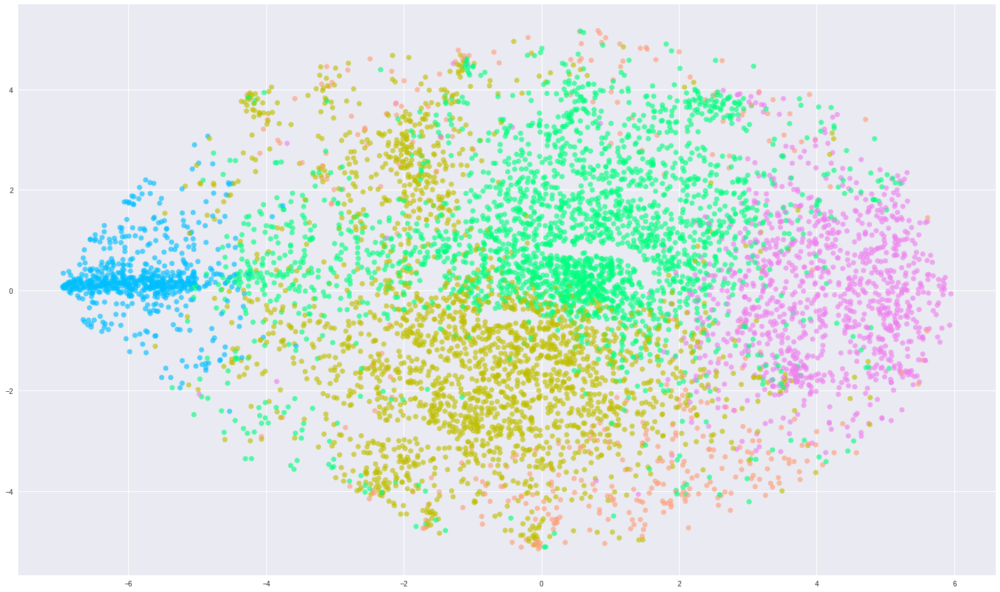

Gen 12...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 1501 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.025s...
[t-SNE] Computed neighbors for 7761 samples in 16.731s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 1.203864
[t-SNE] KL divergence after 250 iterations with early exaggeration: 13.570924
[t-SNE] KL divergence after 500 iterations: 1.648669
Removing outliers. . .


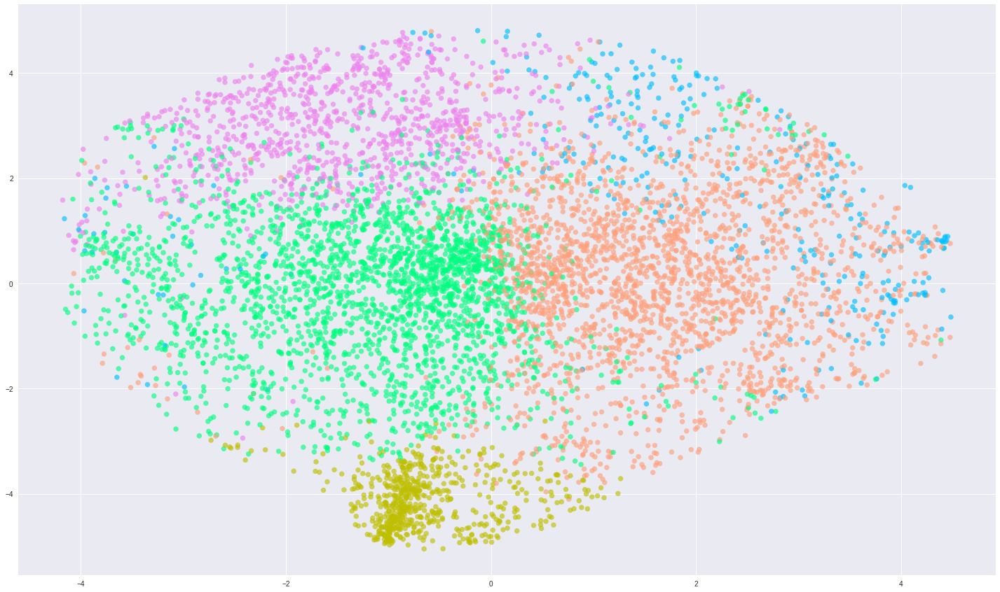

Gen 13...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.025s...
[t-SNE] Computed neighbors for 7761 samples in 12.983s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.745276
[t-SNE] KL divergence after 250 iterations with early exaggeration: 104.216507
[t-SNE] KL divergence after 500 iterations: 3.714385
Removing outliers. . .


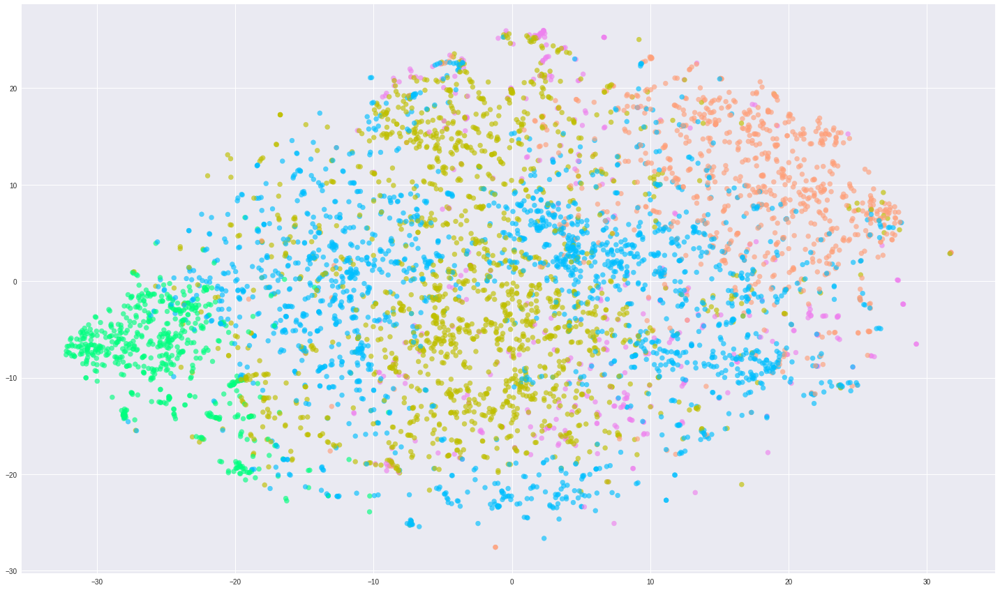

Gen 14...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.025s...
[t-SNE] Computed neighbors for 7761 samples in 13.065s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.797966
[t-SNE] KL divergence after 250 iterations with early exaggeration: 101.189156
[t-SNE] KL divergence after 500 iterations: 3.512023
Removing outliers. . .


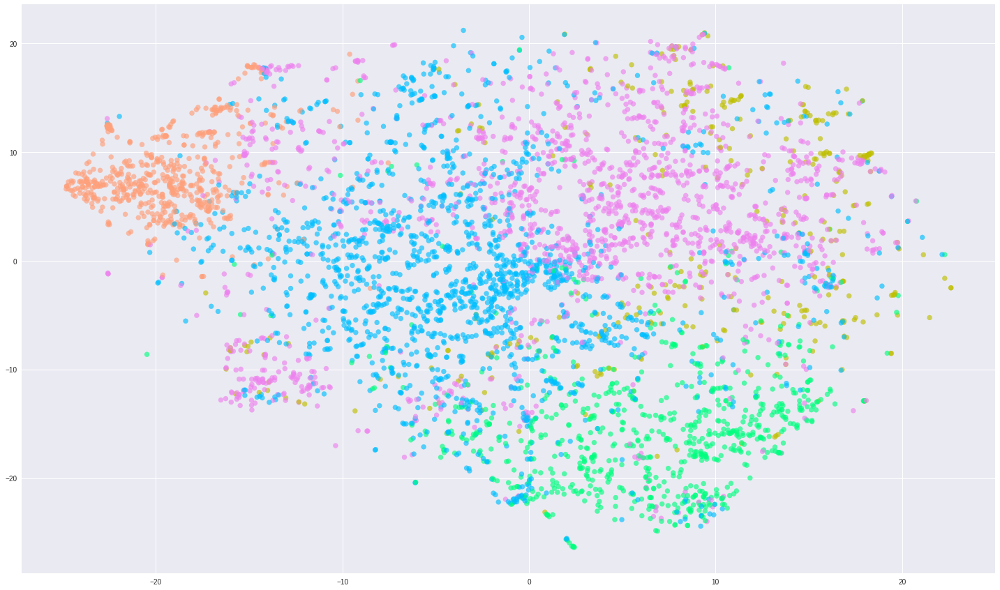

Gen 15...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.026s...
[t-SNE] Computed neighbors for 7761 samples in 13.486s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.835009
[t-SNE] KL divergence after 250 iterations with early exaggeration: 96.581604
[t-SNE] KL divergence after 500 iterations: 3.378422
Removing outliers. . .


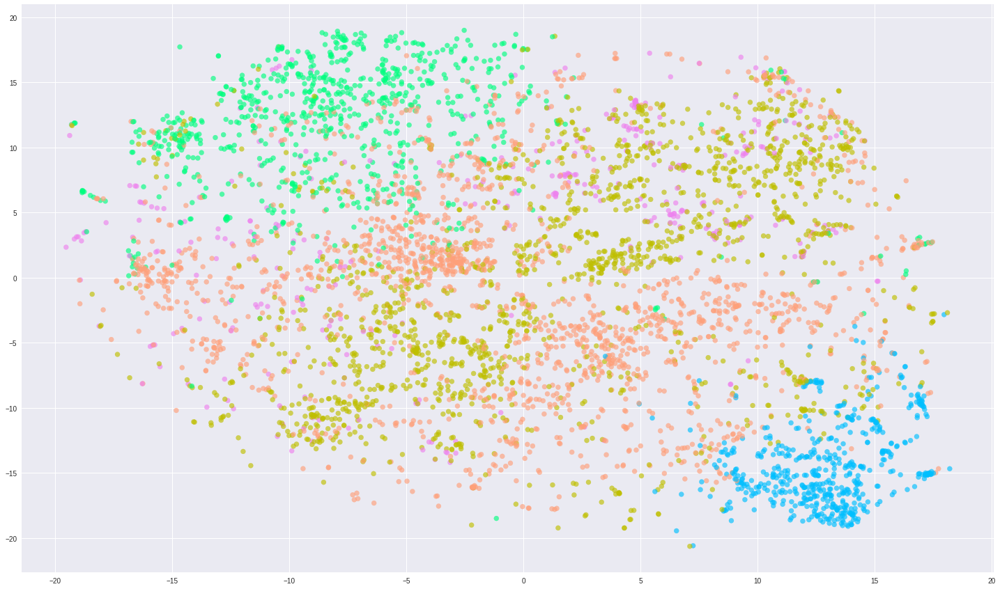

Gen 16...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.025s...
[t-SNE] Computed neighbors for 7761 samples in 13.254s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.863779
[t-SNE] KL divergence after 250 iterations with early exaggeration: 91.972977
[t-SNE] KL divergence after 500 iterations: 3.222558
Removing outliers. . .


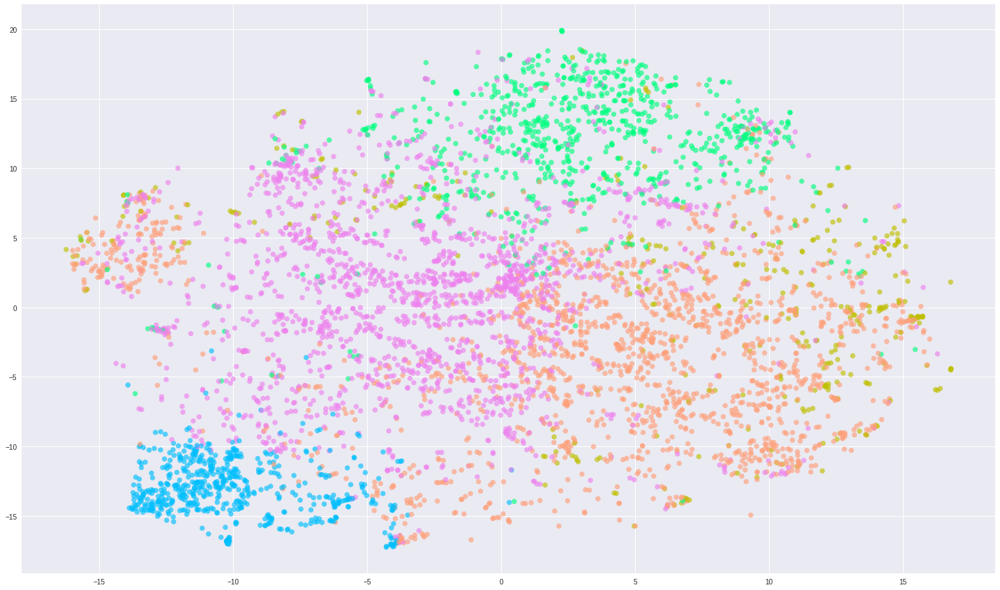

Gen 17...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 181 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.024s...
[t-SNE] Computed neighbors for 7761 samples in 13.447s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.887399
[t-SNE] KL divergence after 250 iterations with early exaggeration: 90.665138
[t-SNE] KL divergence after 500 iterations: 3.095252
Removing outliers. . .


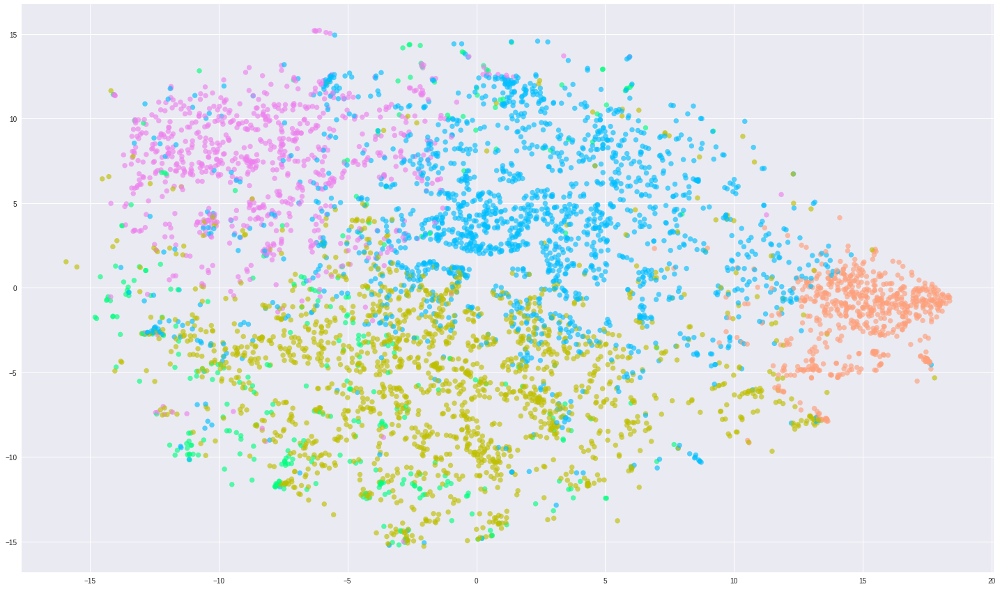

Gen 18...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 211 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.025s...
[t-SNE] Computed neighbors for 7761 samples in 13.399s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.907503
[t-SNE] KL divergence after 250 iterations with early exaggeration: 87.217079
[t-SNE] KL divergence after 500 iterations: 3.004129
Removing outliers. . .


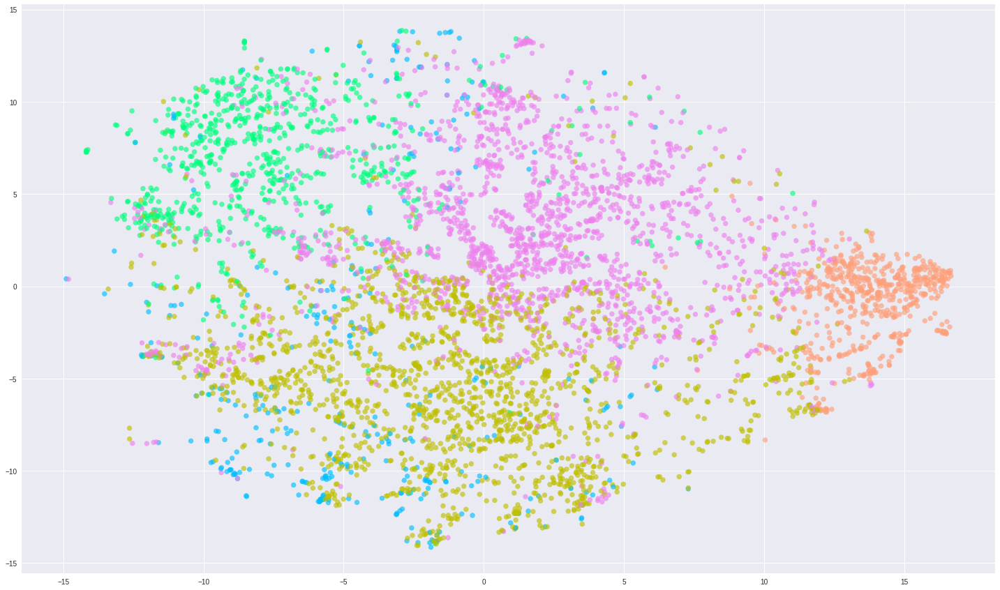

Gen 19...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 241 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.024s...
[t-SNE] Computed neighbors for 7761 samples in 13.769s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.925057
[t-SNE] KL divergence after 250 iterations with early exaggeration: 87.530823
[t-SNE] KL divergence after 500 iterations: 2.947632
Removing outliers. . .


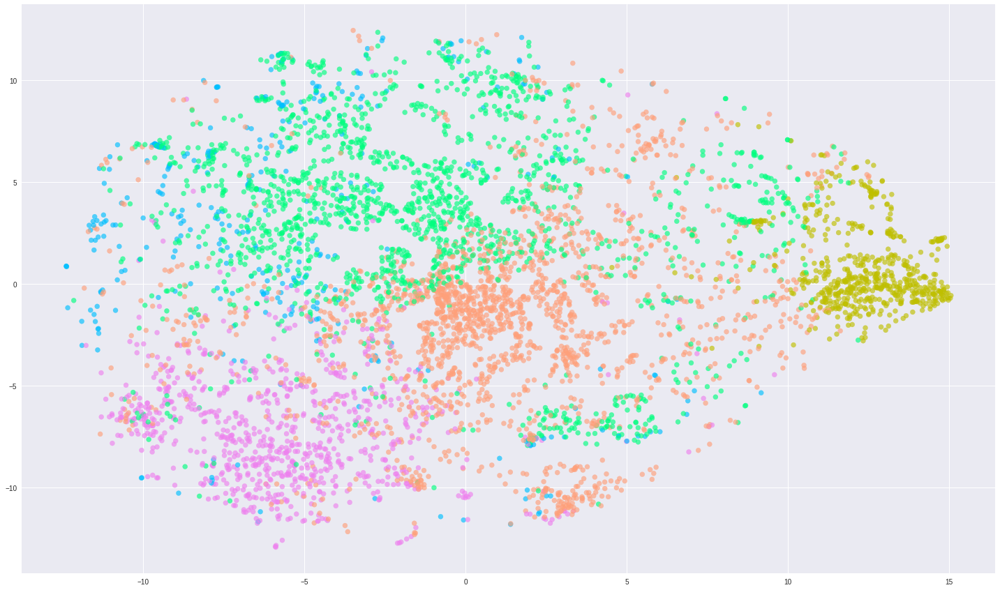

Gen 20...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 271 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.025s...
[t-SNE] Computed neighbors for 7761 samples in 13.565s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.940666
[t-SNE] KL divergence after 250 iterations with early exaggeration: 85.719276
[t-SNE] KL divergence after 500 iterations: 2.889015
Removing outliers. . .


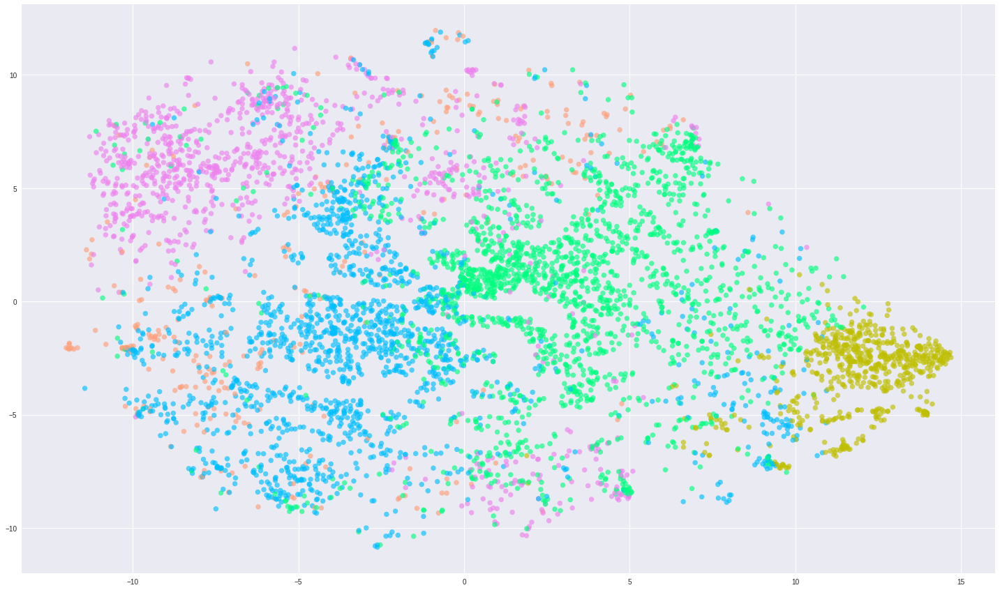

Gen 21...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 301 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.025s...
[t-SNE] Computed neighbors for 7761 samples in 13.885s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.954755
[t-SNE] KL divergence after 250 iterations with early exaggeration: 81.840385
[t-SNE] KL divergence after 500 iterations: 2.820913
Removing outliers. . .


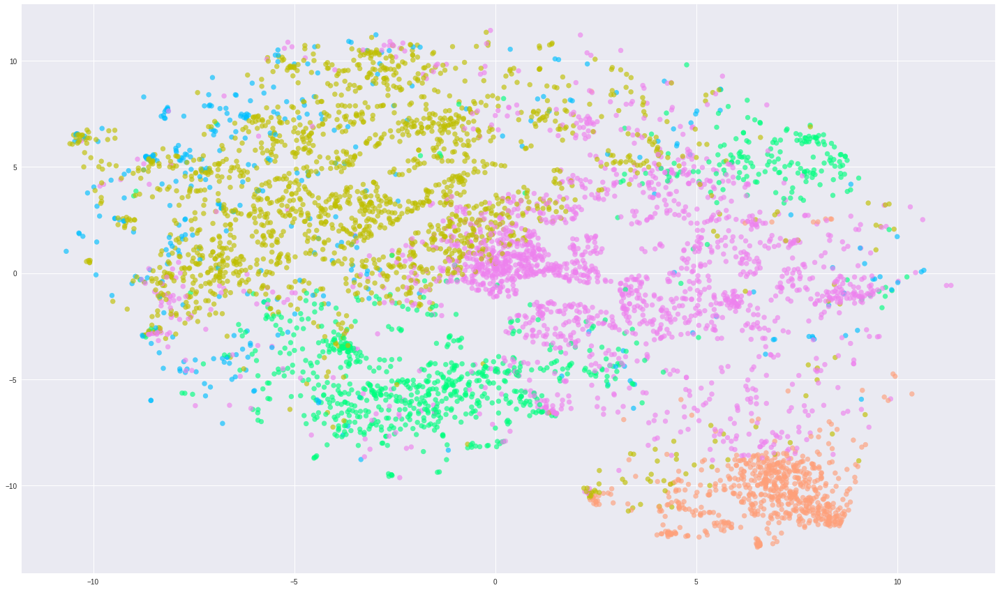

Gen 22...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 331 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.025s...
[t-SNE] Computed neighbors for 7761 samples in 13.622s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.967617
[t-SNE] KL divergence after 250 iterations with early exaggeration: 80.108101
[t-SNE] KL divergence after 500 iterations: 2.790054
Removing outliers. . .


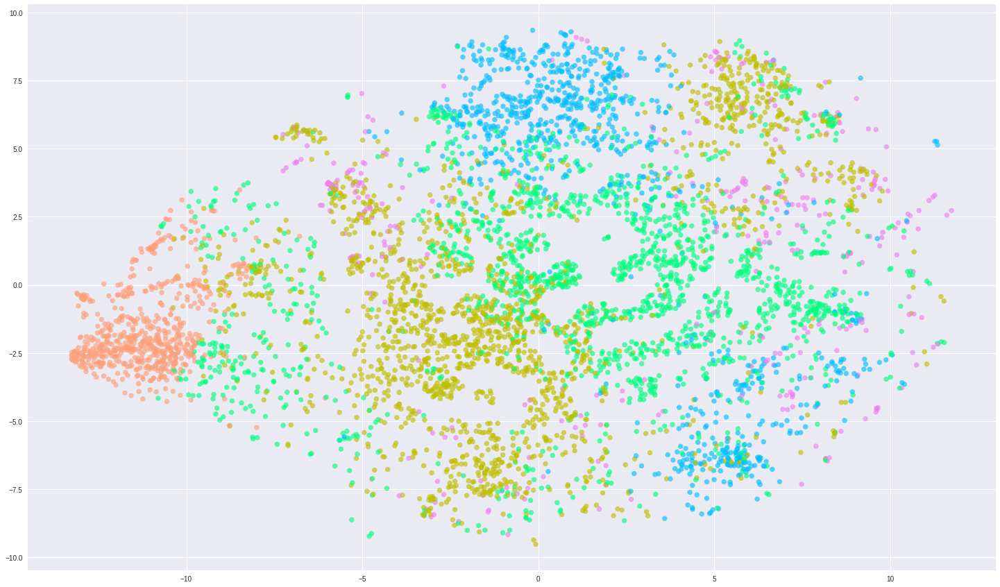

Gen 23...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 451 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.024s...
[t-SNE] Computed neighbors for 7761 samples in 14.184s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 1.010439
[t-SNE] KL divergence after 250 iterations with early exaggeration: 75.769981
[t-SNE] KL divergence after 500 iterations: 2.533182
Removing outliers. . .


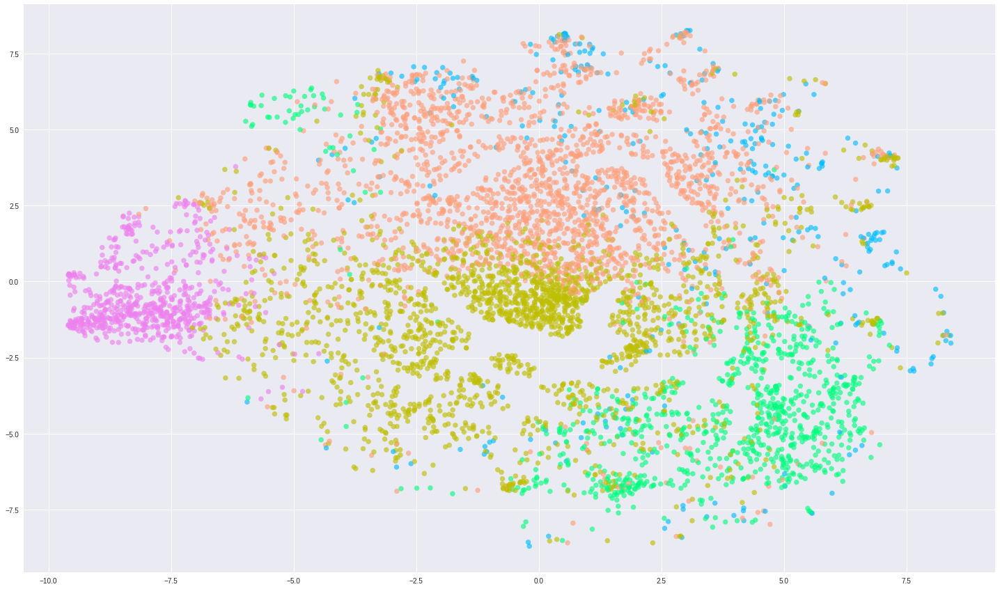

Gen 24...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 901 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.025s...
[t-SNE] Computed neighbors for 7761 samples in 14.988s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 1.114392
[t-SNE] KL divergence after 250 iterations with early exaggeration: 64.417648
[t-SNE] KL divergence after 500 iterations: 2.009192
Removing outliers. . .


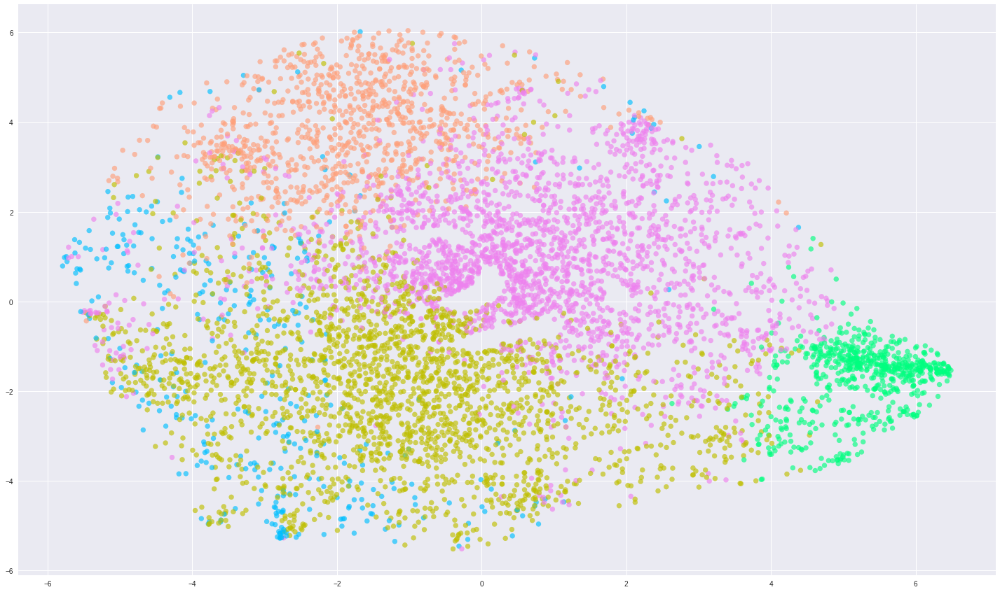

Gen 25...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 1501 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.024s...
[t-SNE] Computed neighbors for 7761 samples in 16.477s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 1.203864
[t-SNE] KL divergence after 250 iterations with early exaggeration: 55.083275
[t-SNE] KL divergence after 500 iterations: 1.660288
Removing outliers. . .


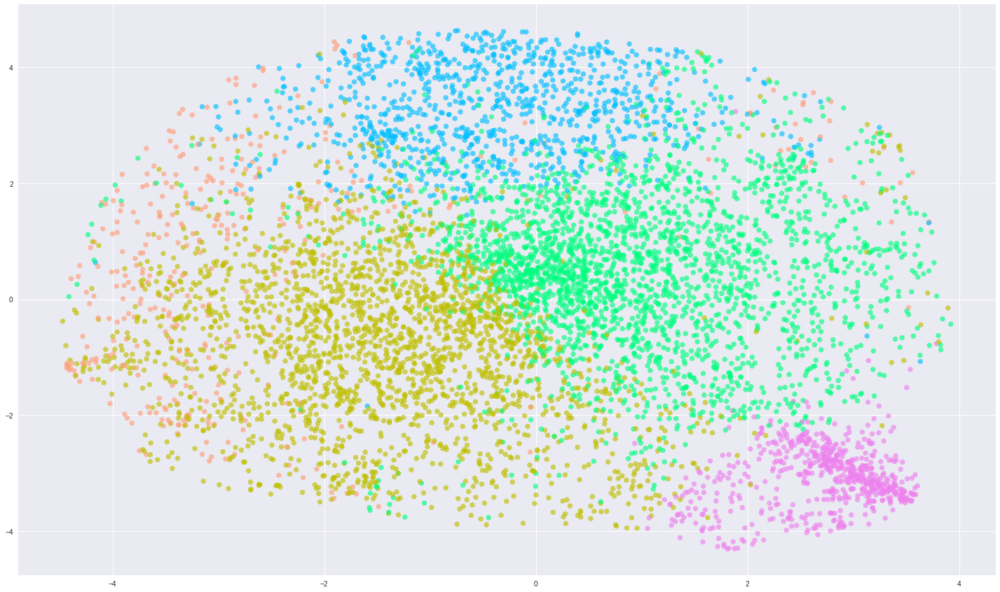

In [0]:
gridSearch = [{"embedder": "tsne", "perplexity":20 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":30 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":40 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":50 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":60 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":70 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":80 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":90 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":100 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":110 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":150 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":300 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":500 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":20 , "n_iter": 500, "exaggeration": 12},
             {"embedder": "tsne", "perplexity":30 , "n_iter": 500, "exaggeration": 12},
             {"embedder": "tsne", "perplexity":40 , "n_iter": 500, "exaggeration": 12},
             {"embedder": "tsne", "perplexity":50 , "n_iter": 500, "exaggeration": 12},
             {"embedder": "tsne", "perplexity":60 , "n_iter": 500, "exaggeration": 12},
             {"embedder": "tsne", "perplexity":70 , "n_iter": 500, "exaggeration": 12},
             {"embedder": "tsne", "perplexity":80 , "n_iter": 500, "exaggeration": 12},
             {"embedder": "tsne", "perplexity":90 , "n_iter": 500, "exaggeration": 12},
             {"embedder": "tsne", "perplexity":100 , "n_iter": 500, "exaggeration": 12},
             {"embedder": "tsne", "perplexity":110 , "n_iter": 500, "exaggeration": 12},
             {"embedder": "tsne", "perplexity":150 , "n_iter": 500, "exaggeration": 12},
             {"embedder": "tsne", "perplexity":300 , "n_iter": 500, "exaggeration": 12},
             {"embedder": "tsne", "perplexity":500 , "n_iter": 500, "exaggeration": 12}]
for i,d in enumerate(gridSearch):
  print('Gen {}...'.format(i))
  plotEmbeddedWords(addText = False, **d)

In [0]:
gridSearch = [{"embedder": "tsne", "perplexity":300 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":400 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":500 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":600 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":700 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":800 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":900 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":1000 , "n_iter": 500, "exaggeration": 4}]
for i,d in enumerate(gridSearch):
  print('Gen {}...'.format(i))
  plotEmbeddedWords(addText = False, **d)

Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 301 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.024s...
[t-SNE] Computed neighbors for 7761 samples in 13.555s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.954755
[t-SNE] KL divergence after 250 iterations with early exaggeration: 92.307152
[t-SNE] KL divergence after 500 iterations: 2.787413
Removing outliers. . .
Plotting words. . .


/usr/local/lib/python3.6/dist-packages/gensim/matutils.py:737: FutureWarning: Conversion of the second argument of issubdtype from `int` to `np.signedinteger` is deprecated. In future, it will be treated as `np.int64 == np.dtype(int).type`.
  if np.issubdtype(vec.dtype, np.int):


Adjusting overlapping text (This may take awhile). . .
40


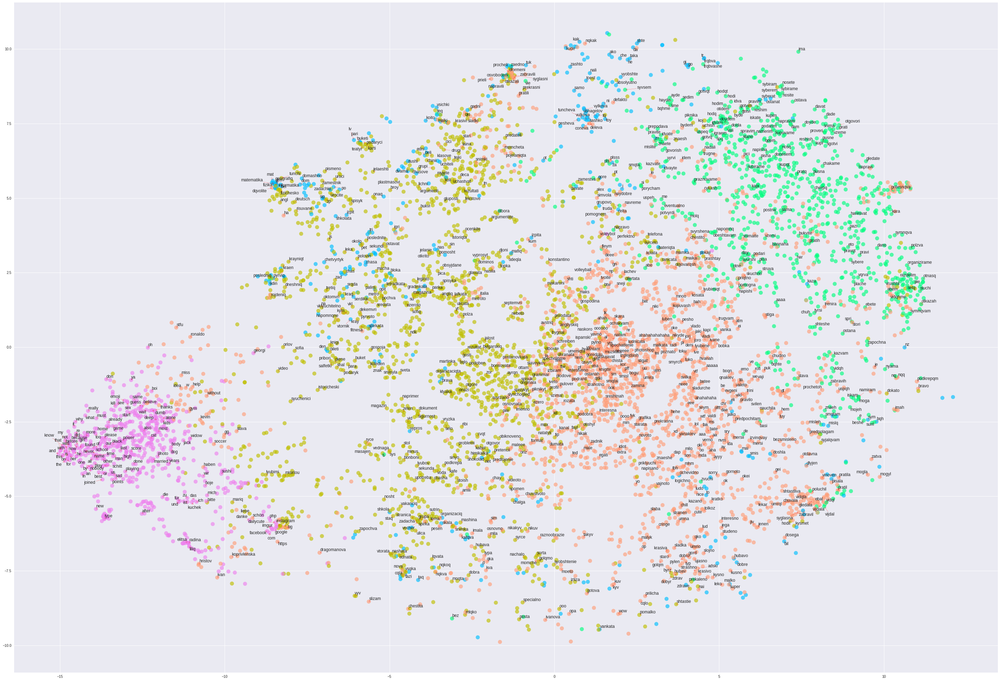

In [0]:
d = {"embedder": "tsne", "perplexity":100 , "n_iter": 500, "exaggeration": 13, 'big':True}
plotEmbeddedWords(addText = True, **d)

In [0]:
chars = sorted(list(set(text)))
print('total chars:', len(chars))
char_indices = dict((c, i) for i, c in enumerate(chars))
indices_char = dict((i, c) for i, c in enumerate(chars))

# cut the text in semi-redundant sequences of maxlen characters
maxlen = 10
step = 3
temp = clean_doc(text)
sentences1 = []
for s in temp:
  for w in s:
    sentences1.append(w)
sentences = []
next_word = []
for i in range(0, len(sentences1) - maxlen, step):
    sentences.append(sentences1[i: i + maxlen])
    next_word.append(sentences1[i + maxlen])
print('nb sequences:', len(sentences))
print(sentences[:100])

print('Vectorization...')
x = np.zeros((len(sentences), maxlen, numVectors), dtype=np.bool)
y = np.zeros((len(sentences), numVectors), dtype=np.bool)
model = gensim.models.word2vec.Word2Vec.load('mymodel')
for i, sentence in enumerate(sentences):
    for t, word in enumerate(sentence):
        x[i, t] = model[word]
    y[i] = model[next_word[i]]

total chars: 49
nb sequences: 6901
[['zhertvame', 'gi', 'v', 'polza', 'na', 'kolektiva', 'kirev', 'e', 'vinoven', 'warten'], ['polza', 'na', 'kolektiva', 'kirev', 'e', 'vinoven', 'warten', 'ot', 'chasa', 'li'], ['kirev', 'e', 'vinoven', 'warten', 'ot', 'chasa', 'li', 'dnevnika', 'changed', 'the'], ['warten', 'ot', 'chasa', 'li', 'dnevnika', 'changed', 'the', 'chat', 'colors', 'imame'], ['li', 'dnevnika', 'changed', 'the', 'chat', 'colors', 'imame', 'ot', 'chasa', 'syshtoto'], ['the', 'chat', 'colors', 'imame', 'ot', 'chasa', 'syshtoto', 'zhaki', 'do', 'ima'], ['imame', 'ot', 'chasa', 'syshtoto', 'zhaki', 'do', 'ima', 'izpit', 'na', 'skypi'], ['syshtoto', 'zhaki', 'do', 'ima', 'izpit', 'na', 'skypi', 'syuchenici', 'byrz', 'vypros'], ['ima', 'izpit', 'na', 'skypi', 'syuchenici', 'byrz', 'vypros', 'zhelaete', 'li', 'da'], ['skypi', 'syuchenici', 'byrz', 'vypros', 'zhelaete', 'li', 'da', 'kupuvame', 'buketi', 'na'], ['vypros', 'zhelaete', 'li', 'da', 'kupuvame', 'buketi', 'na', 'vsichki', 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:28: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:29: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).


In [0]:
def sample(preds, temperature=1.0):
    # helper function to sample an index from a probability array
    preds = np.asarray(preds).astype('float64')
    preds = np.log(preds) / temperature
    exp_preds = np.exp(preds)
    preds = exp_preds / np.sum(exp_preds)
    probas = np.random.multinomial(1, preds, 1)
    return np.argmax(probas)


def on_epoch_end(epoch, _):
    model.save('gdrive/My Drive/Models/textModel3.h5')
    # Function invoked at end of each epoch. Prints generated text.
    print()
    print('----- Generating text after Epoch: %d' % epoch)
    start_index = random.randint(0, len(text) - maxlen - 1)
    for diversity in [0.05, 0.2, 0.5]:
        
        print('----- diversity:', diversity)

        generated = ''
        sentence = text[start_index: start_index + maxlen]
        generated += sentence
        print('----- Generating with seed: "' + sentence + '"')
        sys.stdout.write(generated)

        for i in range(400):
            x_pred = np.zeros((1, maxlen, len(chars)))
            for t, char in enumerate(sentence):
                x_pred[0, t, char_indices[char]] = 1.

            preds = model.predict(x_pred, verbose=0)[0]
            next_index = sample(preds, diversity)
            next_char = indices_char[next_index]

            generated += next_char
            sentence = sentence[1:] + next_char

            sys.stdout.write(next_char)
            sys.stdout.flush()
        print()

print_callback = LambdaCallback(on_epoch_end=on_epoch_end)

In [0]:
print('Build model...')
model = Sequential()
model.add(LSTM(256, input_shape=(maxlen, len(chars)), return_sequences=True))
model.add(Dropout(0.2))
model.add(LSTM(256))
model.add(Dropout(0.2))
model.add(Dense(len(chars), activation='softmax'))

optimizer = Adam(lr=0.0005, beta_1 = 0.9)
model.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics = ['accuracy'])

model.fit(x, y,
          batch_size=128,
          epochs=60,
callbacks=[print_callback])

In [0]:
model = load_model('gdrive/My Drive/Models/textModel.h5')
optimizer = Adam(lr=0.0001, beta_1 = 0.9)
model.compile(loss='categorical_crossentropy', optimizer=optimizer,  metrics=['accuracy'])
print_callback = LambdaCallback(on_epoch_end=on_epoch_end)
print_callback5 = LambdaCallback(on_epoch_end=on_epoch_end5)
model.fit(x, y,
          batch_size=128,
          epochs=60,
          callbacks=[print_callback],
         )

In [0]:
from textgenrnn import textgenrnn

my_file = open("text.txt", 'w+', encoding='utf-8')
text = getTextFromUser(['Alex Savova'])
text = remove_rare_chars(text,50)

print("header",file=my_file)
print(text,file=my_file)
my_file.close()

textgen = textgenrnn()
textgen.train_from_file('text.txt',
                        new_model=True,
                        num_epochs=200,
                        gen_epochs=5,
                        word_level=True,
                        train_size=0.85,
                        dropout=0.3)